In [90]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

import bar_chart_race as bcr

import geopandas as gpd


In [ ]:
df = pd.read_csv("file_name.csv")
df

,Date,Country/Region,Confirmed,Deaths,Recovered,Active,New cases,New deaths,New recovered,WHO Region
0,22/1/2020,Afghanistan,0,0,0,0,0,0,0,Eastern Mediterranean
1,22/1/2020,Albania,0,0,0,0,0,0,0,Europe
2,22/1/2020,Algeria,0,0,0,0,0,0,0,Africa
3,22/1/2020,Andorra,0,0,0,0,0,0,0,Europe
4,22/1/2020,Angola,0,0,0,0,0,0,0,Africa
...,...,...,...,...,...,...,...,...,...,...
35151,27/7/2020,West Bank and Gaza,10621,78,3752,6791,152,2,0,Eastern Mediterranean
35152,27/7/2020,Western Sahara,10,1,8,1,0,0,0,Africa
35153,27/7/2020,Yemen,1691,483,833,375,10,4,36,Eastern Mediterranean
35154,27/7/2020,Zambia,4552,140,2815,1597,71,1,465,Africa


In [92]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 35156 entries, 0 to 35155
Data columns (total 10 columns):
 #   Column          Non-Null Count  Dtype 
---  ------          --------------  ----- 
 0   Date            35156 non-null  object
 1   Country/Region  35156 non-null  object
 2   Confirmed       35156 non-null  int64 
 3   Deaths          35156 non-null  int64 
 4   Recovered       35156 non-null  int64 
 5   Active          35156 non-null  int64 
 6   New cases       35156 non-null  int64 
 7   New deaths      35156 non-null  int64 
 8   New recovered   35156 non-null  int64 
 9   WHO Region      35156 non-null  object
dtypes: int64(7), object(3)
memory usage: 2.7+ MB


In [93]:
# Check for duplicate rows in the DataFrame
duplicate_rows = df[df.duplicated()]
print(duplicate_rows)

print("==============================")

null_counts = df.isnull().sum()
print(null_counts)
print(null_counts.sum())


Empty DataFrame
Columns: [Date, Country/Region, Confirmed, Deaths, Recovered, Active, New cases, New deaths, New recovered, WHO Region]
Index: []
Date              0
Country/Region    0
Confirmed         0
Deaths            0
Recovered         0
Active            0
New cases         0
New deaths        0
New recovered     0
WHO Region        0
dtype: int64
0


In [94]:
# Convert Date column to datetime format
df['Date'] = pd.to_datetime(df['Date'], format="%d/%m/%Y")

df['Month'] = df['Date'].dt.month
df['Month_Name'] = df['Date'].dt.strftime('%B')


In [95]:
df.info()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 35156 entries, 0 to 35155
Data columns (total 12 columns):
 #   Column          Non-Null Count  Dtype         
---  ------          --------------  -----         
 0   Date            35156 non-null  datetime64[ns]
 1   Country/Region  35156 non-null  object        
 2   Confirmed       35156 non-null  int64         
 3   Deaths          35156 non-null  int64         
 4   Recovered       35156 non-null  int64         
 5   Active          35156 non-null  int64         
 6   New cases       35156 non-null  int64         
 7   New deaths      35156 non-null  int64         
 8   New recovered   35156 non-null  int64         
 9   WHO Region      35156 non-null  object        
 10  Month           35156 non-null  int32         
 11  Month_Name      35156 non-null  object        
dtypes: datetime64[ns](1), int32(1), int64(7), object(3)
memory usage: 3.1+ MB


In [96]:
df

,Date,Country/Region,Confirmed,Deaths,Recovered,Active,New cases,New deaths,New recovered,WHO Region,Month,Month_Name
0,2020-01-22,Afghanistan,0,0,0,0,0,0,0,Eastern Mediterranean,1,January
1,2020-01-22,Albania,0,0,0,0,0,0,0,Europe,1,January
2,2020-01-22,Algeria,0,0,0,0,0,0,0,Africa,1,January
3,2020-01-22,Andorra,0,0,0,0,0,0,0,Europe,1,January
4,2020-01-22,Angola,0,0,0,0,0,0,0,Africa,1,January
...,...,...,...,...,...,...,...,...,...,...,...,...
35151,2020-07-27,West Bank and Gaza,10621,78,3752,6791,152,2,0,Eastern Mediterranean,7,July
35152,2020-07-27,Western Sahara,10,1,8,1,0,0,0,Africa,7,July
35153,2020-07-27,Yemen,1691,483,833,375,10,4,36,Eastern Mediterranean,7,July
35154,2020-07-27,Zambia,4552,140,2815,1597,71,1,465,Africa,7,July


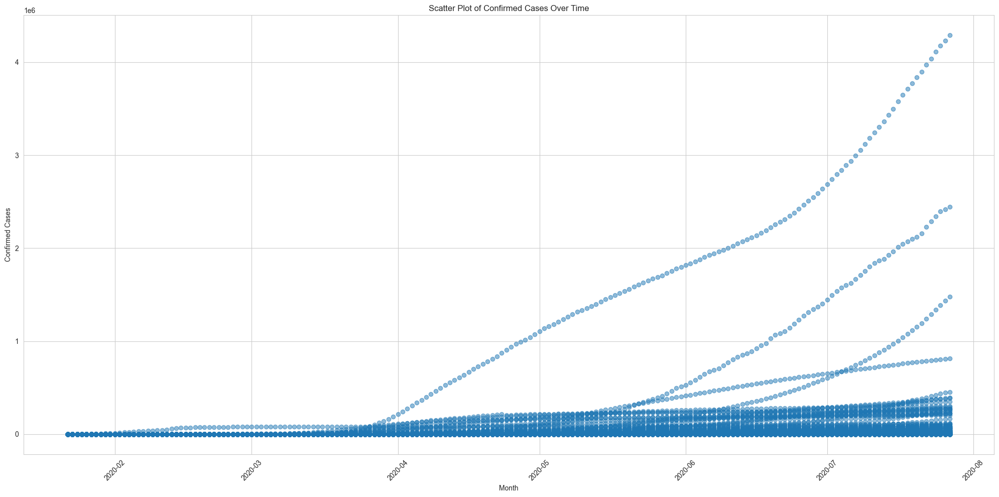

In [121]:
# Scatter plot
plt.figure(figsize=(20, 10))
plt.scatter(df['Date'], df['Confirmed'], alpha=0.5)
plt.title('Scatter Plot of Confirmed Cases Over Time')
plt.xlabel('Month')
plt.ylabel('Confirmed Cases')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

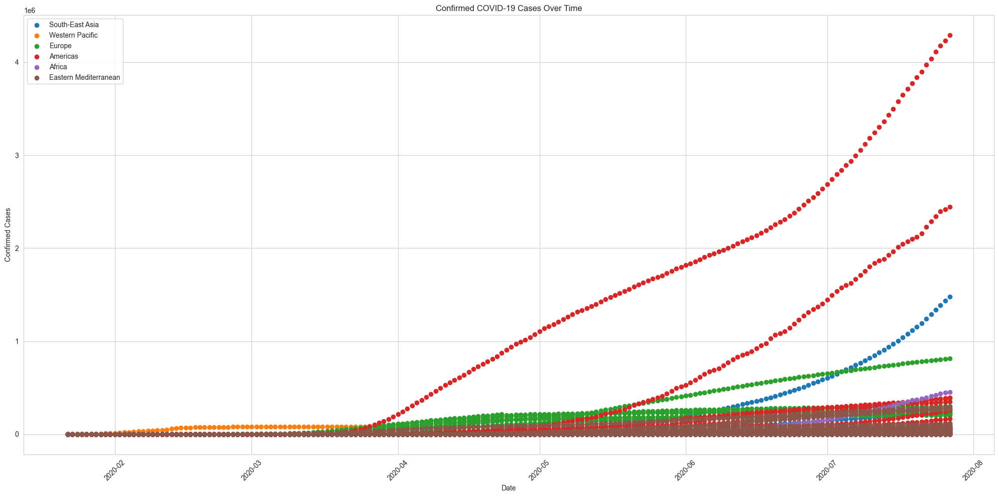

In [117]:
# Group the data by 'Country/Region'
grouped_data = df.groupby('WHO Region')

# Plot confirmed cases over time for selected WHO regions
plt.figure(figsize=(20, 10))

selected_regions = ['South-East Asia', 'Western Pacific', 'Europe', 'Americas', 'Africa', 'Eastern Mediterranean']

for region in selected_regions:
    region_data = grouped_data.get_group(region)
    plt.scatter(region_data['Date'], region_data['Confirmed'], label=region)
    
    
plt.title('Confirmed COVID-19 Cases Over Time')
plt.xlabel('Date')
plt.ylabel('Confirmed Cases')
plt.legend()
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

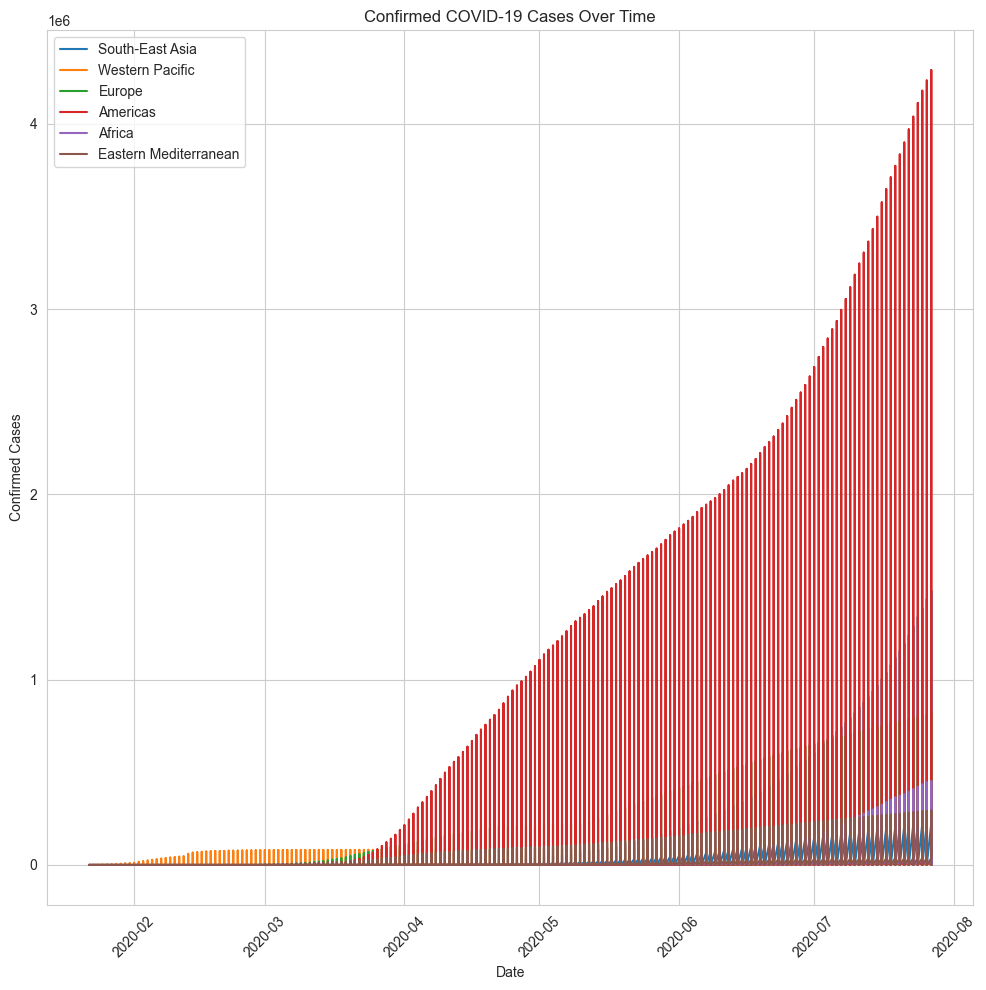

In [99]:
# Group the data by 'Country/Region'
grouped_data = df.groupby('WHO Region')

# Plot confirmed cases over time for selected WHO regions
plt.figure(figsize=(20, 10))

selected_regions = ['South-East Asia', 'Western Pacific', 'Europe', 'Americas', 'Africa', 'Eastern Mediterranean']

for region in selected_regions:
    region_data = grouped_data.get_group(region)
    plt.plot(region_data['Date'], region_data['Confirmed'], label=region)
    
    
plt.title('Confirmed COVID-19 Cases Over Time')
plt.xlabel('Date')
plt.ylabel('Confirmed Cases')
plt.legend()
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

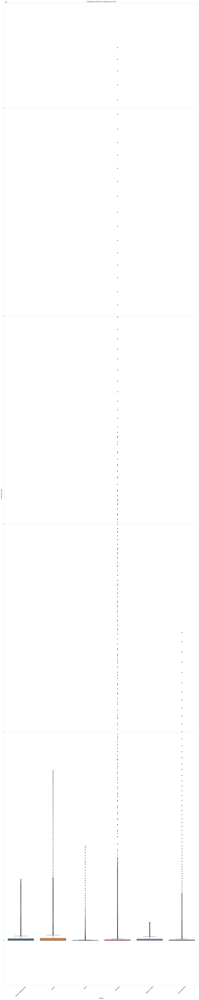

In [123]:
# Create box plot
plt.figure(figsize=(20, 100))
sns.boxplot(x='WHO Region', y='Confirmed', data=df)
plt.title('Confirmed COVID-19 Cases Over Time')
plt.xlabel('Region')
plt.ylabel('Confirmed Cases')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

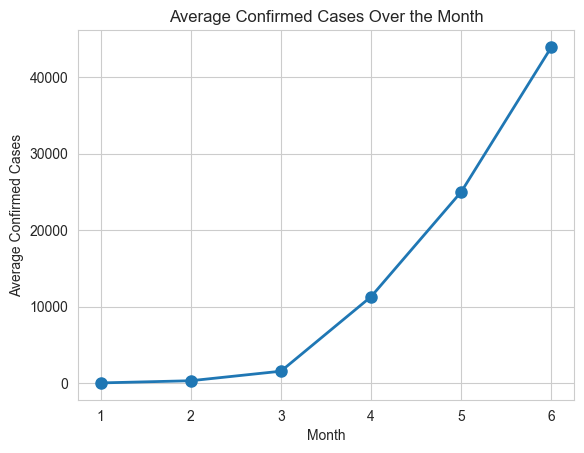

In [101]:

# Group by year and calculate average confirmed cases
monthly_data = df.groupby('Month')['Confirmed'].mean().reset_index()


# Initialize the plot
fig, ax = plt.subplots()
line, = ax.plot([], [], lw=2, marker='o', markersize=8)
ax.set_xlabel('Month')
ax.set_ylabel('Average Confirmed Cases')
ax.set_title('Average Confirmed Cases Over the Month')

# Function to initialize the plot
def init():
    line.set_data([], [])
    return line,

# Function to animate the plot
def animate(i):
    x = monthly_data['Month'].iloc[:i]
    y = monthly_data['Confirmed'].iloc[:i]
    line.set_data(range(1, len(x) + 1), y)
    ax.relim()
    ax.autoscale_view()
    return line,

# Create animation
ani = FuncAnimation(fig, animate, init_func=init, frames=len(monthly_data), interval=200, blit=True)

# Display the animation
HTML(ani.to_jshtml())


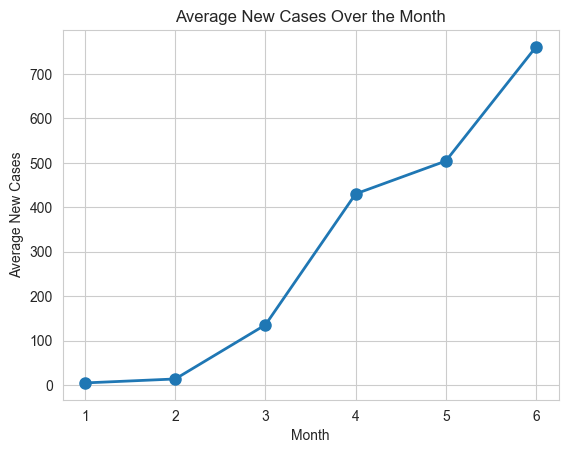

In [102]:

# Group by year and calculate average confirmed cases
monthly_data = df.groupby('Month')['New cases'].mean().reset_index()


# Initialize the plot
fig, ax = plt.subplots()
line, = ax.plot([], [], lw=2, marker='o', markersize=8)
ax.set_xlabel('Month')
ax.set_ylabel('Average New Cases')
ax.set_title('Average New Cases Over the Month')

# Function to initialize the plot
def init():
    line.set_data([], [])
    return line,

# Function to animate the plot
def animate(i):
    x = monthly_data['Month'].iloc[:i]
    y = monthly_data['New cases'].iloc[:i]
    line.set_data(range(1, len(x) + 1), y)
    ax.relim()
    ax.autoscale_view()
    return line,

# Create animation
ani = FuncAnimation(fig, animate, init_func=init, frames=len(monthly_data), interval=200, blit=True)

# Display the animation
HTML(ani.to_jshtml())


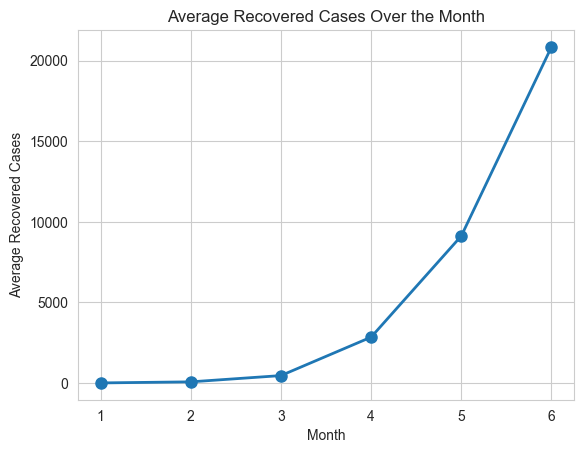

In [103]:

# Group by year and calculate average confirmed cases
monthly_data = df.groupby('Month')['Recovered'].mean().reset_index()


# Initialize the plot
fig, ax = plt.subplots()
line, = ax.plot([], [], lw=2, marker='o', markersize=8)
ax.set_xlabel('Month')
ax.set_ylabel('Average Recovered Cases')
ax.set_title('Average Recovered Cases Over the Month')

# Function to initialize the plot
def init():
    line.set_data([], [])
    return line,

# Function to animate the plot
def animate(i):
    x = monthly_data['Month'].iloc[:i]
    y = monthly_data['Recovered'].iloc[:i]
    line.set_data(range(1, len(x) + 1), y)
    ax.relim()
    ax.autoscale_view()
    return line,

# Create animation
ani = FuncAnimation(fig, animate, init_func=init, frames=len(monthly_data), interval=200, blit=True)

# Display the animation
HTML(ani.to_jshtml())


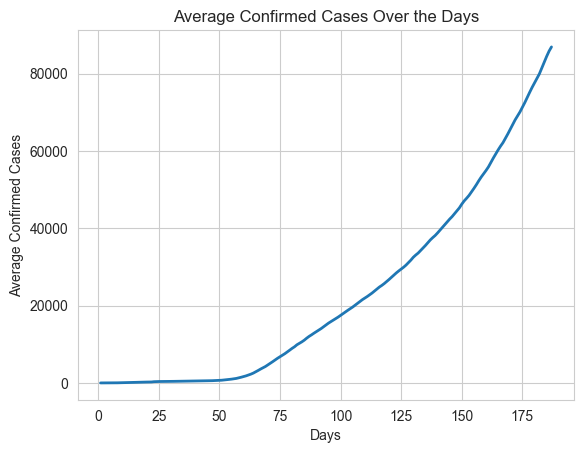

In [104]:

# Group by year and calculate average confirmed cases
monthly_data = df.groupby('Date')['Confirmed'].mean().reset_index()

# Initialize the plot
fig, ax = plt.subplots()
line, = ax.plot([], [], lw=2)
ax.set_xlabel('Days')
ax.set_ylabel('Average Confirmed Cases')
ax.set_title('Average Confirmed Cases Over the Days')

# Function to initialize the plot
def init():
    line.set_data([], [])
    return line,

# Function to animate the plot
def animate(i):
    x = monthly_data['Date'].iloc[:i]
    y = monthly_data['Confirmed'].iloc[:i]
    line.set_data(range(1, len(x) + 1), y)
    ax.relim()
    ax.autoscale_view()
    return line,

# Create animation
ani = FuncAnimation(fig, animate, init_func=init, frames=len(monthly_data), interval=200, blit=True)

# Display the animation
HTML(ani.to_jshtml())


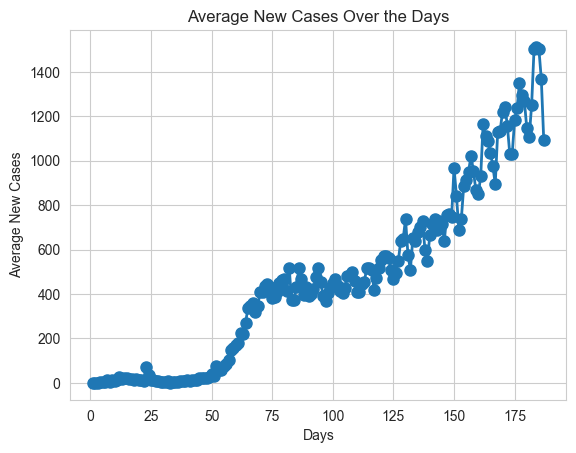

In [105]:
# Group by year and calculate average confirmed cases
monthly_data = df.groupby('Date')['New cases'].mean().reset_index()

# Initialize the plot
fig, ax = plt.subplots()
line, = ax.plot([], [], lw=2, marker='o', markersize=8)
ax.set_xlabel('Days')
ax.set_ylabel('Average New Cases')
ax.set_title('Average New Cases Over the Days')

# Function to initialize the plot
def init():
    line.set_data([], [])
    return line,

# Function to animate the plot
def animate(i):
    x = monthly_data['Date'].iloc[:i]
    y = monthly_data['New cases'].iloc[:i]
    line.set_data(range(1, len(x) + 1), y)
    ax.relim()
    ax.autoscale_view()
    return line,

# Create animation
ani = FuncAnimation(fig, animate, init_func=init, frames=len(monthly_data), interval=200, blit=True)

# Display the animation
HTML(ani.to_jshtml())


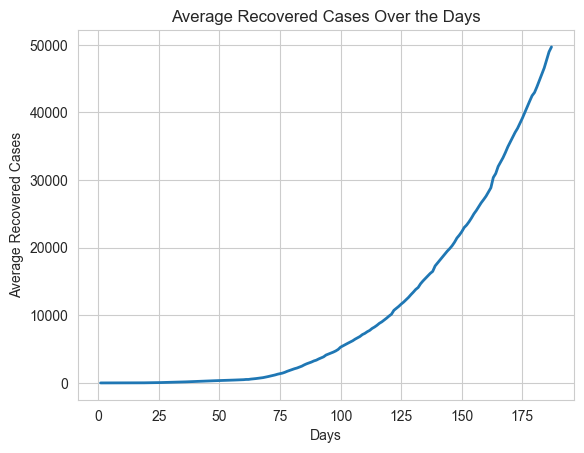

In [106]:
# Group by year and calculate average confirmed cases
monthly_data = df.groupby('Date')['Recovered'].mean().reset_index()

# Initialize the plot
fig, ax = plt.subplots()
line, = ax.plot([], [], lw=2)
ax.set_xlabel('Days')
ax.set_ylabel('Average Recovered Cases')
ax.set_title('Average Recovered Cases Over the Days')
sns.set_style("whitegrid")

# Function to initialize the plot
def init():
    line.set_data([], [])
    return line,

# Function to animate the plot
def animate(i):
    x = monthly_data['Date'].iloc[:i]
    y = monthly_data['Recovered'].iloc[:i]
    line.set_data(range(1, len(x) + 1), y)
    ax.relim()
    ax.autoscale_view()
    return line,

# Create animation
ani = FuncAnimation(fig, animate, init_func=init, frames=len(monthly_data), interval=200, blit=True)

# Display the animation
HTML(ani.to_jshtml())


In [107]:
df

,Date,Country/Region,Confirmed,Deaths,Recovered,Active,New cases,New deaths,New recovered,WHO Region,Month,Month_Name
0,2020-01-22,Afghanistan,0,0,0,0,0,0,0,Eastern Mediterranean,1,January
1,2020-01-22,Albania,0,0,0,0,0,0,0,Europe,1,January
2,2020-01-22,Algeria,0,0,0,0,0,0,0,Africa,1,January
3,2020-01-22,Andorra,0,0,0,0,0,0,0,Europe,1,January
4,2020-01-22,Angola,0,0,0,0,0,0,0,Africa,1,January
...,...,...,...,...,...,...,...,...,...,...,...,...
35151,2020-07-27,West Bank and Gaza,10621,78,3752,6791,152,2,0,Eastern Mediterranean,7,July
35152,2020-07-27,Western Sahara,10,1,8,1,0,0,0,Africa,7,July
35153,2020-07-27,Yemen,1691,483,833,375,10,4,36,Eastern Mediterranean,7,July
35154,2020-07-27,Zambia,4552,140,2815,1597,71,1,465,Africa,7,July


c:\Users\Owner\AppData\Local\Programs\Python\Python312\Lib\site-packages\bar_chart_race\_make_chart.py:889: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df_values.iloc[:, 0] = df_values.iloc[:, 0].fillna(method='ffill')
c:\Users\Owner\AppData\Local\Programs\Python\Python312\Lib\site-packages\bar_chart_race\_make_chart.py:284: UserWarning: Glyph 127 () missing from current font.
  fig.canvas.print_figure(io.BytesIO())
c:\Users\Owner\AppData\Local\Programs\Python\Python312\Lib\site-packages\bar_chart_race\_make_chart.py:284: UserWarning: Glyph 128 (\x80) missing from current font.
  fig.canvas.print_figure(io.BytesIO())
c:\Users\Owner\AppData\Local\Programs\Python\Python312\Lib\site-packages\bar_chart_race\_make_chart.py:284: UserWarning: Glyph 129 (\x81) missing from current font.
  fig.canvas.print_figure(io.BytesIO())
c:\Users\Owner\AppData\Local\Programs\Python\Python312\Lib\site-packages\bar_c

In [109]:
import bar_chart_race as bcr

# Ensure 'Date' column is in datetime format
df['Date'] = pd.to_datetime(df['Date'])

# Set 'Date' as the index and pivot the DataFrame to have 'Country/Region' as columns and 'Date' as rows
pivot_df = df.pivot(index='Date', columns='Country/Region', values='Recovered')

# Fill missing values using forward fill (ffill)
pivot_df.ffill(inplace=True)

# Create the bar chart race
bcr.bar_chart_race(df=pivot_df, filename='covid19_recover.mp4', n_bars=10, period_fmt='%B %d, %Y')


c:\Users\Owner\AppData\Local\Programs\Python\Python312\Lib\site-packages\bar_chart_race\_make_chart.py:889: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df_values.iloc[:, 0] = df_values.iloc[:, 0].fillna(method='ffill')
c:\Users\Owner\AppData\Local\Programs\Python\Python312\Lib\site-packages\bar_chart_race\_make_chart.py:284: UserWarning: Glyph 127 () missing from current font.
  fig.canvas.print_figure(io.BytesIO())
c:\Users\Owner\AppData\Local\Programs\Python\Python312\Lib\site-packages\bar_chart_race\_make_chart.py:284: UserWarning: Glyph 128 (\x80) missing from current font.
  fig.canvas.print_figure(io.BytesIO())
c:\Users\Owner\AppData\Local\Programs\Python\Python312\Lib\site-packages\bar_chart_race\_make_chart.py:284: UserWarning: Glyph 129 (\x81) missing from current font.
  fig.canvas.print_figure(io.BytesIO())
c:\Users\Owner\AppData\Local\Programs\Python\Python312\Lib\site-packages\bar_c

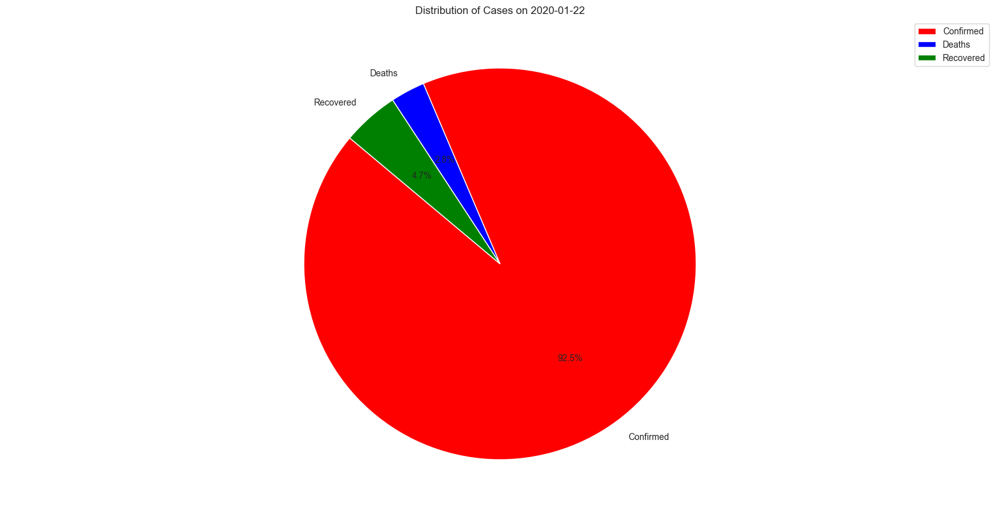

In [118]:

# Group data by date and sum confirmed, deaths, and recovered cases
grouped_data = df.groupby('Date')[['Confirmed', 'Deaths', 'Recovered']].sum()

# Function to animate the pie chart
def animate(i):
    plt.cla()  # Clear the current axis to avoid overlapping plots
    plt.axis('equal')
    plt.title(f'Distribution of Cases on {grouped_data.index[i].strftime("%Y-%m-%d")}')
    
    # Plot the pie chart for the i-th date
    sizes = grouped_data.iloc[i].values
    labels = grouped_data.columns
    colors = ['red', 'blue', 'green']
    plt.pie(sizes, labels=labels, colors=colors, autopct='%1.1f%%', startangle=140)
    plt.legend(loc="best")

# Create the animation
fig = plt.figure(figsize=(20, 10))
ani = FuncAnimation(fig, animate, frames=len(grouped_data), interval=500, repeat=False)

# Display the animation
HTML(ani.to_jshtml())

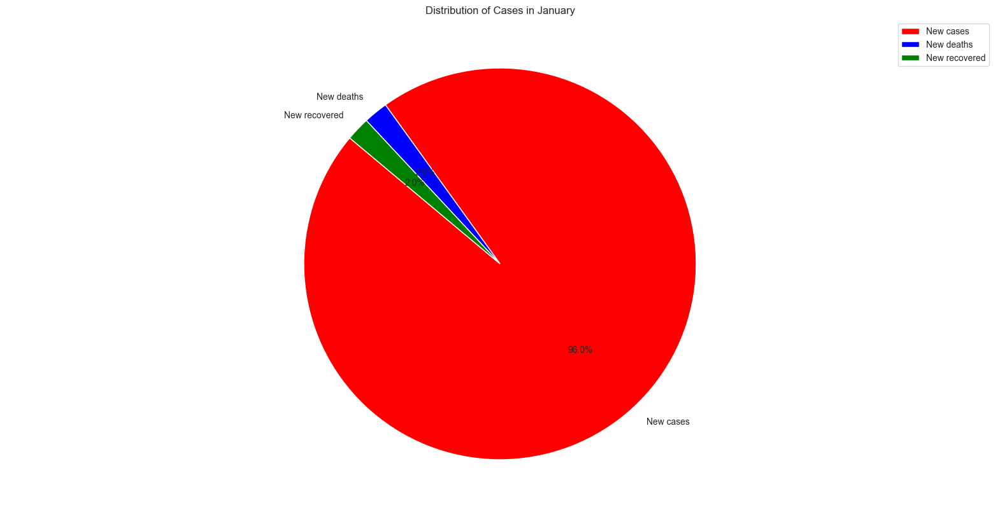

In [119]:
import calendar
# Group data by date and sum confirmed, deaths, and recovered cases
grouped_data = df.groupby('Month')[['New cases', 'New deaths', 'New recovered']].sum()

month_names = [calendar.month_name[i] for i in range(1, 13)]

# Function to animate the pie chart
def animate(i):
    plt.cla()  # Clear the current axis to avoid overlapping plots
    plt.axis('equal')
    month_name = month_names[i]
    plt.title(f'Distribution of Cases in {month_name}') 
    
    # Plot the pie chart for the i-th date
    sizes = grouped_data.iloc[i].values
    labels = grouped_data.columns
    colors = ['red', 'blue', 'green']
    plt.pie(sizes, labels=labels, colors=colors, autopct='%1.1f%%', startangle=140)
    plt.legend(loc="best")

# Create the animation
fig = plt.figure(figsize=(20, 10))
ani = FuncAnimation(fig, animate, frames=len(grouped_data), interval=500, repeat=False)

# Display the animation
HTML(ani.to_jshtml())

C:\Users\Owner\AppData\Local\Temp\ipykernel_15736\3141436292.py:2: FutureWarning: The geopandas.dataset module is deprecated and will be removed in GeoPandas 1.0. You can get the original 'naturalearth_lowres' data from https://www.naturalearthdata.com/downloads/110m-cultural-vectors/.
  world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))


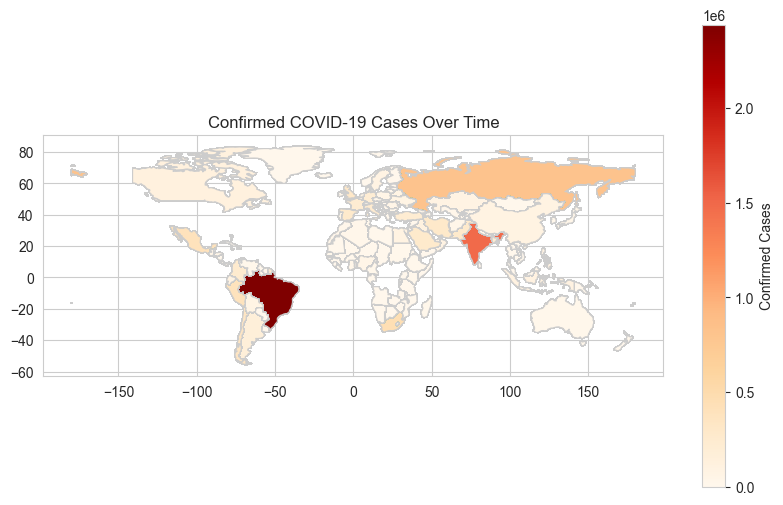

In [116]:

# Load world map data
world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))

# Group data by country and date and sum confirmed cases
grouped_data = df.groupby(['Country/Region', 'Date'])['Confirmed'].sum().reset_index()

# Merge world map data with confirmed cases data
world = world.merge(grouped_data, how='left', left_on='name', right_on='Country/Region')

# Plot the world map with confirmed cases
fig, ax = plt.subplots(figsize=(20, 10))


world.plot(column='Confirmed', cmap='OrRd', linewidth=0.8, ax=ax, edgecolor='0.8', legend=True, legend_kwds={'label': "Confirmed Cases"})
ax.set_title('Confirmed COVID-19 Cases Over Time')
plt.show()
